<a href="https://colab.research.google.com/github/sidh26/Face-Detection/blob/master/MaskRCNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -q cython pyyaml==5.1

     |████████████████████████████████| 276kB 7.4MB/s 


In [2]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -q -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 14, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 5564 (delta 2), reused 6 (delta 2), pack-reused 5550
Receiving objects: 100% (5564/5564), 2.56 MiB | 4.86 MiB/s, done.
Resolving deltas: 100% (4011/4011), done.


In [1]:
!pip install -q -U watermark

In [2]:
%reload_ext watermark
%watermark -v -p numpy,pandas,pycocotools,torch,torchvision,detectron2

CPython 3.6.9
IPython 5.5.0

numpy 1.18.5
pandas 1.0.4
pycocotools 2.0.1
torch 1.5.0+cu101
torchvision 0.6.0+cu101
detectron2 0.1.3


In [3]:
import torch, torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import os
import ntpath
import numpy as np
import pandas as pd
import cv2
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor 
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from glob import glob
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

################################## LIBRARIES NOT NEEDED. USE IT ONLY IF YOURE GETTING ANY ERROR.
#import random
#import itertools
#import pandas as pd
#from tqdm import tqdm
#import urllib
#import json
#import PIL.Image as Image
#from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
#from detectron2.evaluation import COCOEvaluator, inference_on_dataset
#from detectron2.engine import DefaultPredictor, DefaultTrainer
#from detectron2.structures import BoxMode
#import seaborn as sns
#from pylab import rcParams
#import matplotlib.pyplot as plt
# from matplotlib import rc
# %matplotlib inline
# %config InlineBackend.figure_format='retina'
# sns.set(style='whitegrid', palette='muted', font_scale=1.2)
# HAPPY_COLORS_PALETTE = ["#01BEFE", "#FFDD00", "#FF7D00", "#FF006D", "#ADFF02", "#8F00FF"]
# sns.set_palette(sns.color_palette(HAPPY_COLORS_PALETTE))
# rcParams['figure.figsize'] = 12, 8

In [4]:
cfg = get_cfg()

cfg.merge_from_file(
    model_zoo.get_config_file(
        "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
        )
    )

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(
    "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
    )

In [5]:
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
cfg.TEST.EVAL_PERIOD = 500

In [6]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True) 
!gdown --id 18Ev2bpdKsBaDufhVKf0cT6RmM3FjW3nL
!mv face_detector.pth output/model_final.pth

Downloading...
From: https://drive.google.com/uc?id=18Ev2bpdKsBaDufhVKf0cT6RmM3FjW3nL
To: /content/face_detector.pth
856MB [00:04, 176MB/s]


In [7]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.4 #YOU CAN CHANGE THE THRESHOLD
predictor = DefaultPredictor(cfg)

In [51]:
di = "a50"
os.makedirs(di, exist_ok=True)
test_image_paths = glob('/content/class/*.JPG')

In [52]:
test_image_paths

['/content/class/Vidit Doshi.JPG',
 '/content/class/Riddhi Mehta.JPG',
 '/content/class/Kanishq Thakkar.JPG',
 '/content/class/Jenil Gathani.JPG',
 '/content/class/Hrithika Shukla.JPG',
 '/content/class/Sneha Valia.JPG',
 '/content/class/Sidh Satam.JPG',
 '/content/class/Husain Ghadiali.JPG',
 '/content/class/Ojasvi Jain.JPG',
 '/content/class/Soham Mhatre.JPG',
 '/content/class/Poojan Mehta.JPG',
 '/content/class/Yash Mahadeshwar.JPG',
 '/content/class/Nidhi Bhatt.JPG',
 '/content/class/Harshwardhan Palav.JPG',
 '/content/class/Aakash Kumar.JPG',
 '/content/class/Manas Tokale.JPG',
 '/content/class/Devesh Patodia.JPG',
 '/content/class/Amrusha Buddhiraju.JPG',
 '/content/class/Payasvi Pathak.JPG',
 '/content/class/Atharva Surve.JPG',
 '/content/class/Aadityaharan Ganesh.JPG',
 '/content/class/Kaashan Panjwani.JPG',
 '/content/class/Sakshi Gehani.JPG',
 '/content/class/Aaryak Shandilya.JPG',
 '/content/class/Mitali Kambli.JPG',
 '/content/class/Atharv Navandar.JPG',
 '/content/class/Aa

In [54]:
from time import time

In [55]:
rows = []
total_time = 0
for clothing_image in test_image_paths:
    print(clothing_image)
    file_path = clothing_image
    im = cv2.imread(file_path)
    start_time = time()
    outputs = predictor(im)
    end_time = time()
    total_time += end_time - start_time
    # v = Visualizer(
    #     im[:, :, ::-1],
    #     scale=1., 
    #     instance_mode=ColorMode.IMAGE
    # )
    instances = outputs["instances"].to("cpu")
    instances.remove('pred_masks')
    scores = instances.get_fields()["scores"].tolist()
    pred_boxes = instances.get_fields()["pred_boxes"].tensor.tolist()
    bounding_box = pred_boxes[np.argmax(scores)]
    rows.append([os.path.basename(clothing_image), *bounding_box])
    # v = v.draw_instance_predictions(instances)
    # result = v.get_image()[:, :, ::-1]
    # file_name = ntpath.basename(clothing_image)
    # write_res = cv2.imwrite(f'{di}/{file_name}', result)

/content/class/Vidit Doshi.JPG
/content/class/Riddhi Mehta.JPG
/content/class/Kanishq Thakkar.JPG
/content/class/Jenil Gathani.JPG
/content/class/Hrithika Shukla.JPG
/content/class/Sneha Valia.JPG
/content/class/Sidh Satam.JPG
/content/class/Husain Ghadiali.JPG
/content/class/Ojasvi Jain.JPG
/content/class/Soham Mhatre.JPG
/content/class/Poojan Mehta.JPG
/content/class/Yash Mahadeshwar.JPG
/content/class/Nidhi Bhatt.JPG
/content/class/Harshwardhan Palav.JPG
/content/class/Aakash Kumar.JPG
/content/class/Manas Tokale.JPG
/content/class/Devesh Patodia.JPG
/content/class/Amrusha Buddhiraju.JPG
/content/class/Payasvi Pathak.JPG
/content/class/Atharva Surve.JPG
/content/class/Aadityaharan Ganesh.JPG
/content/class/Kaashan Panjwani.JPG
/content/class/Sakshi Gehani.JPG
/content/class/Aaryak Shandilya.JPG
/content/class/Mitali Kambli.JPG
/content/class/Atharv Navandar.JPG
/content/class/Aaryan Jethva.JPG
/content/class/Yashvardhan Singh Ranawat.JPG
/content/class/Sanika Mhadgut.JPG
/content/cl

In [57]:
total_time/len(rows)

0.9618062462125506

In [58]:
df = pd.DataFrame(rows, columns=['Image Name', 'C1', 'C2', 'C3', 'C4'])
df.to_csv('maskrcnn_detection.csv')

In [14]:
from google.colab.patches import cv2_imshow

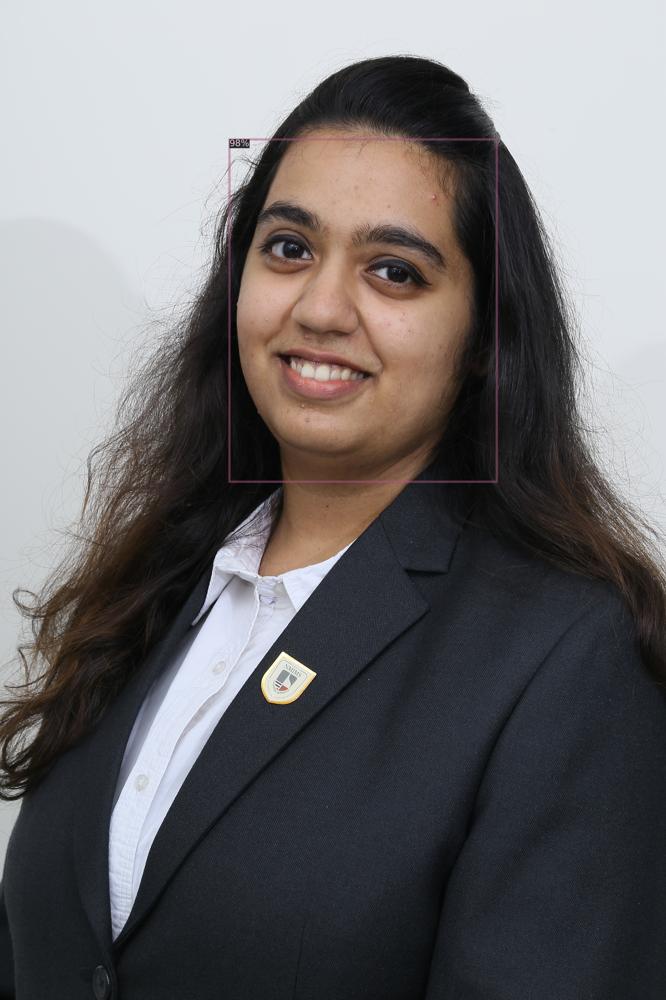

In [15]:
cv2_imshow(result)

In [31]:
scores = instances.get_fields()["scores"].tolist()
pred_classes = instances.get_fields()["pred_classes"].tolist()
pred_boxes = instances.get_fields()["pred_boxes"].tensor.tolist()

In [34]:
pred_boxes

[[1257.081787109375, 763.77880859375, 2720.900634765625, 2636.6103515625]]